In [64]:
# Requirements
# Cython==0.28.2
# numpy==1.14.2
# scipy==1.0.1
# pandas==0.23.0
# scikit-learn==0.19.1
# matplotlib==2.2.2
# plotly==2.5.1
# scikit-image==0.14.0
# imageio==2.3.0

In [67]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objs as go
from imageio import imread
from matplotlib.pyplot import imshow
from plotly.offline import init_notebook_mode, iplot, plot
init_notebook_mode(connected=True)
%matplotlib inline

uint8 (387, 412, 4)


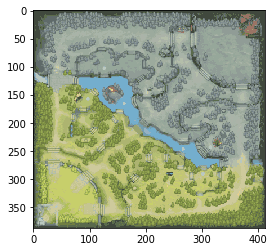

In [68]:
# Load and display
img = imread('Minimap_7.07_resized_dithered.png')
imshow(img)
print(img.dtype, img.shape)

(32, 3)


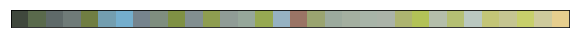

In [71]:
# Find colors
img_array = img[:, :, :3].reshape((img.shape[0] * img.shape[1], 3))
colors = np.unique(img_array, axis=0)
n_colors = colors.shape[0]
print(colors.shape)

# Show colors
def show_colors(colors):
    colors_matrix = np.reshape(colors, [4, n_colors // 4, 3])
    imshow(np.reshape(colors, (1, -1, 3)))
    plt.xticks([])
    plt.yticks([])
    plt.gcf().set_size_inches(10, 1)
show_colors(colors)

(32, 3)


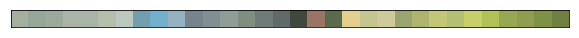

In [75]:
# Sort colors
from colormath.color_diff import delta_e_cie2000
from colormath.color_objects import LabColor, sRGBColor
from colormath.color_conversions import convert_color
from pants import World, Solver
def rgb_distance(color1, color2):
    color1 = sRGBColor(*color1)
    color2 = sRGBColor(*color2)
    color1 = convert_color(color1, LabColor)
    color2 = convert_color(color2, LabColor)
    return float(delta_e_cie1976(color1, color2))
colors = [tuple(c) for c in colors]
solution = Solver().solve(World(colors, rgb_distance))
colors = np.array(solution.tour)
print(colors.shape)
show_colors(colors)

In [76]:
# Create a custom colormap
color_to_value = {tuple(color[:3]): i / (n_colors - 1) for i, color in enumerate(colors)}
my_cmap_ply = [(value, 'rgb({}, {}, {})'.format(*color)) for color, value in color_to_value.items()]

In [86]:
# Map pixels to values
fun_find_value = lambda x: color_to_value[tuple(x[:3])]
values = np.apply_along_axis(fun_find_value, 2, img)

In [87]:
yy = np.linspace(0, 1, img.shape[0])
xx = np.linspace(0, 1, img.shape[1])
zz = np.zeros(img.shape[:2])

surf = go.Surface(
    x=xx, y=yy, z=zz,
    colorscale=my_cmap_ply,
    surfacecolor=values,
    showscale=False
)
fig = go.Figure(data=go.Data([surf]), layout=go.Layout())


plot(fig, filename='dota2-terrain.html', auto_open=False)
iplot(fig)

In [88]:
# Load the data of a game
import re

# df = pd.read_csv('2842186236.csv')
# df = pd.read_csv('2842231681.csv')
df = pd.read_csv('2842231742.csv')
# df = pd.read_csv('2842269046.csv')
# Only keep X, Y and Deaths columns
cols = [col for col in df.columns if col.startswith('X_') or col.startswith('Y_') or col.startswith('Deaths_')] + ['tick']
df = df[cols]

# Forward-fill missing values
df.ffill(inplace=True)

# Infer players data from column names
players = []
pattern = re.compile(r'[^_]+_([0-9])_(R|D)_([a-z_]+)_(W|L)')
for col in df.columns:
    if not col.startswith('X_'):
        continue
    
    match = re.match(pattern, col)
    if match:
        player_id, team, hero, outcome = match.group(1), match.group(2), match.group(3), match.group(4)
        players.append((player_id, team, hero, outcome))

# For every hero
traces = []
styles = {}
for player_id, team, hero, outcome in players:
    col_part = '_{player_id}_{team}_{hero}_{outcome}'.format(
        player_id=player_id, team=team, hero=hero, outcome=outcome)
    color = '#0088FF' if team == 'D' else '#FF530D'
    styles[hero] = {
        'mode': 'lines',
        'line': go.Line(color=color),
        'legendgroup': hero.replace('_', ' ').title(),
        'name': '{hero} ({team})'.format(hero=hero.replace('_', ' ').title(), team=team)
    }
    
    # Group the sequences of locations by associated number of deaths and plot each sequence
    # This is to avoid "teleportations" to the base
    for _, sub_df in df.groupby('Deaths' + col_part):
        xx = sub_df['X'+col_part].values
        yy = sub_df['Y'+col_part].values
        zz = sub_df['tick'].values
        style = styles[hero]
        trace = go.Scatter3d(
            x=xx, y=yy, z=zz,
            showlegend=False,
            **style
        )
        traces.append(trace)

        
for legend_group, style in styles.items():
    trace = go.Scatter3d(
        x=[np.nan], y=[np.nan], z=[np.nan],
        **style
    )
    traces.append(trace)

In [89]:
yy = np.linspace(-8000, +8000, img.shape[0])
xx = np.linspace(-8000, +8000, img.shape[1])
zz = np.full(img.shape[:2], -90)

surf = go.Surface(
    x=xx, y=yy, z=zz,
    colorscale=my_cmap_ply,
    surfacecolor=values,
    showscale=False
)


layout = go.Layout(
    margin=dict(l=0,r=0,b=0,t=0),
    scene=go.Scene(
        xaxis=go.XAxis(title='', showticklabels=False),
        yaxis=go.YAxis(title='', showticklabels=False),
        zaxis=go.ZAxis(title='Time (s)'),
        aspectratio=dict(x=1, y=1, z=1.8)
    )
)
fig = go.Figure(data=go.Data([surf] + traces), layout=layout)

iplot(fig, filename='dota2-terrain-and-paths')

In [120]:
from plotly.offline import plot
plot(fig, filename='dota.html', auto_open=False)

'file:///Users/marcotamassia/dota.html'